# Proyecto 2 Data Science
## Incumplimiento de Pago de Tarjeta de Credito
#### Ricardo Valenzuela
#### Sara Zavala
#### Juan Diego Solorzano

## Problema Cientifico

En los años de la pandemia, en los Estados Unidos de América, el comportamiento del uso de tarjetas de crédito ha variado bastante. El promedio de la deuda de tarjeta de crédito creció en 52% entre el 2020 y el 2019, sin embargo, este porcentaje ha caído significativamente en el 2020 (ValuePenguin) (Household Debt and Credit Report, NewYorkFed). Este proyecto pretende utilizar conceptos y metodos de Data Science para predecir que tipo de clientes tienden a caer en impago basandose en los datos disponibles en el archivo UCI_Credit_Card.

## Objetivos
Generales:
- Identificar a los tipos de clientes que pueden caer en impago

Especificos:
- Identificar que variable(s) tienen el mayor impacto en las deudas de tarjeta de credito
- Desarrollar modelos vistos en clase y predicciones sobre los clientes con deuda de tarjeta de credito 
- Identificar a que se debe el comportamiento que demuestran los porcentajes de deuda en los ultimos años

## Analisis Exploratorio

Descripcion del dataset:

Hay 25 variables (22 cuantitativas, 3 categoricas):

- ID: ID de cada cliente
- LIMIT_BAL: cantidad del crédito otorgado en dólares NT (incluye crédito individual y familiar / suplementario
- SEX: Género (1 = masculino, 2 = femenino)
- EDUCATION: (1 = estudios de posgrado, 2 = universidad, 3 = bachillerato, 4 = otros, 5 =desconocidos, 6 = desconocidos)
- MARRIAGE: Estado civil (1 = casado, 2 = soltero, 3 = otros)
- AGE: Edad en años
- PAY_0: Estado de reembolso en septiembre de 2005 (-1 = pago debidamente, 1 = retrasoen el pago durante un mes, 2 = retraso en el pago durante dos meses,... 8 = retraso en elpago durante ocho meses, 9 = retraso en el pago durante nueve meses o más)
- PAY_2: Estado de reembolso en agosto de 2005 (escala igual a la anterior)
- PAY_3: Estado de reembolso en julio de 2005 (escala igual a la anterior)
- PAY_4: Estado de reembolso en junio de 2005 (escala igual a la anterior)
- PAY_5: Estado de reembolso en mayo de 2005 (escala igual a la anterior)
- PAY_6: Estado de reembolso en abril de 2005 (escala igual a la anterior)
- BILL_AMT1: Monto de la factura en septiembre de 2005 (dólar NT)
- BILL_AMT2: Monto de la factura en agosto de 2005 (dólar NT)
- BILL_AMT3: Monto de la factura en julio de 2005 (dólar NT)
- BILL_AMT4: Monto de la factura en junio de 2005 (dólar NT)
- BILL_AMT5: Monto de la factura en mayo de 2005 (dólar NT)
- BILL_AMT6: Monto de la factura en abril de 2005 (dólar NT)
- PAY_AMT1: Monto del pago anterior en septiembre de 2005 (dólar NT)
- PAY_AMT2: Monto del pago anterior en agosto de 2005 (dólar NT)
- PAY_AMT3: Monto del pago anterior en julio de 2005 (dólar NT)
- PAY_AMT4: Monto del pago anterior en junio de 2005 (dólar NT)
- PAY_AMT5: Monto del pago anterior en mayo de 2005 (dólar NT)
- PAY_AMT6: Monto del pago anterior en abril de 2005 (dólar NT)
- default.payment.next.month: incumplimiento de pago al mes siguiente (1 = sí, 0 = no)

In [1]:
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport
import seaborn as sn
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv("UCI_Credit_Card.csv")
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [3]:
profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/38 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

array([[<AxesSubplot:title={'center':'ID'}>,
        <AxesSubplot:title={'center':'LIMIT_BAL'}>,
        <AxesSubplot:title={'center':'SEX'}>,
        <AxesSubplot:title={'center':'EDUCATION'}>,
        <AxesSubplot:title={'center':'MARRIAGE'}>],
       [<AxesSubplot:title={'center':'AGE'}>,
        <AxesSubplot:title={'center':'PAY_0'}>,
        <AxesSubplot:title={'center':'PAY_2'}>,
        <AxesSubplot:title={'center':'PAY_3'}>,
        <AxesSubplot:title={'center':'PAY_4'}>],
       [<AxesSubplot:title={'center':'PAY_5'}>,
        <AxesSubplot:title={'center':'PAY_6'}>,
        <AxesSubplot:title={'center':'BILL_AMT1'}>,
        <AxesSubplot:title={'center':'BILL_AMT2'}>,
        <AxesSubplot:title={'center':'BILL_AMT3'}>],
       [<AxesSubplot:title={'center':'BILL_AMT4'}>,
        <AxesSubplot:title={'center':'BILL_AMT5'}>,
        <AxesSubplot:title={'center':'BILL_AMT6'}>,
        <AxesSubplot:title={'center':'PAY_AMT1'}>,
        <AxesSubplot:title={'center':'PAY_AMT2'}>],
  

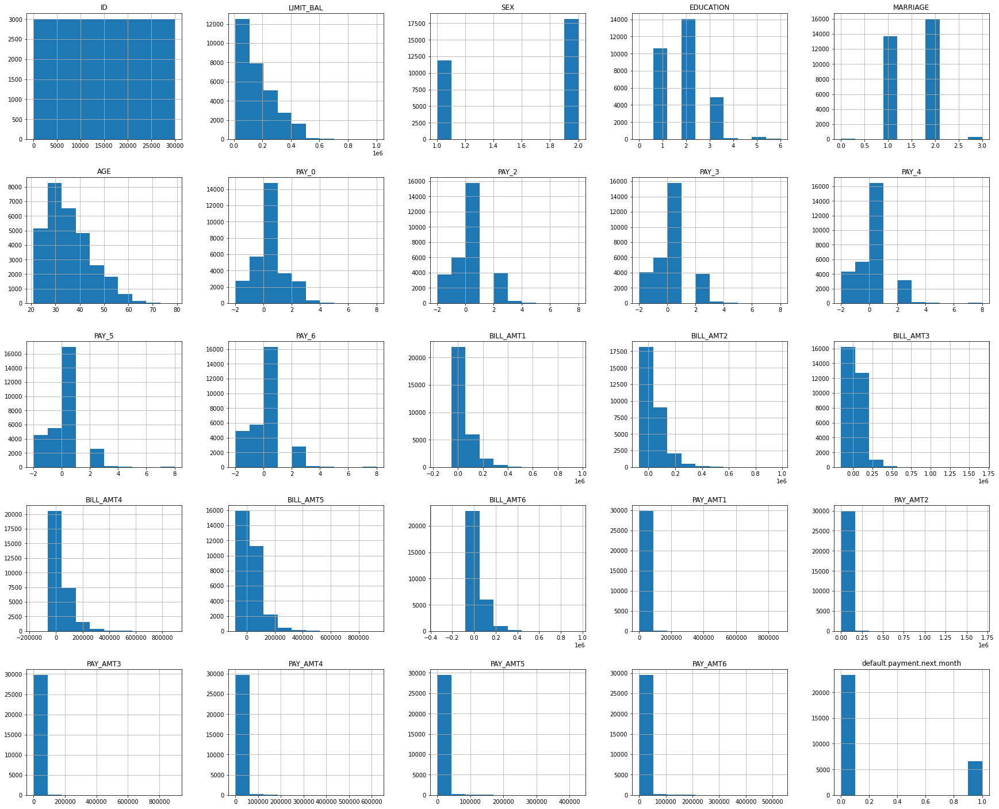

In [4]:
#Creacion de graficas para visualizar cada columna del dataset
df.hist(figsize=(30, 25))

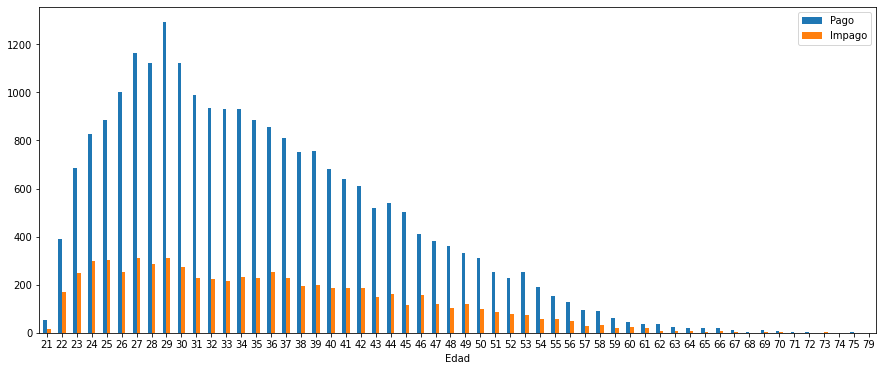

In [5]:
pd.crosstab(df.AGE, df['default.payment.next.month']).plot(kind="bar",figsize=(15,6))
plt.xlabel('Edad')
plt.xticks(rotation=0)
plt.legend(["Pago", "Impago"])
plt.show()

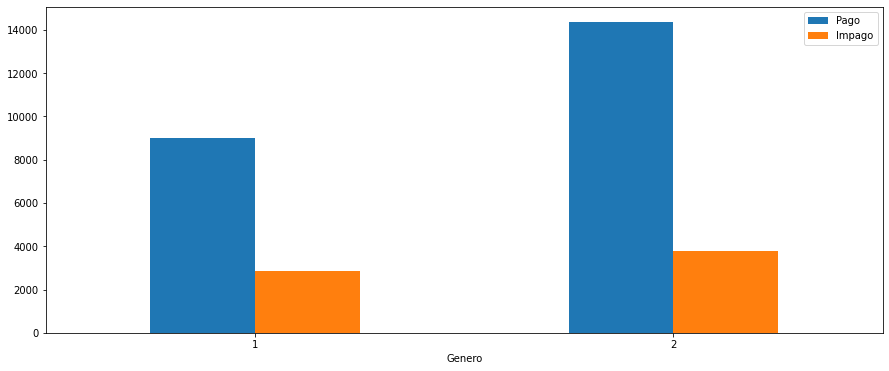

In [6]:
pd.crosstab(df.SEX, df['default.payment.next.month']).plot(kind="bar",figsize=(15,6))
plt.xlabel('Genero')
plt.xticks(rotation=0)
plt.legend(["Pago", "Impago"])
plt.show()

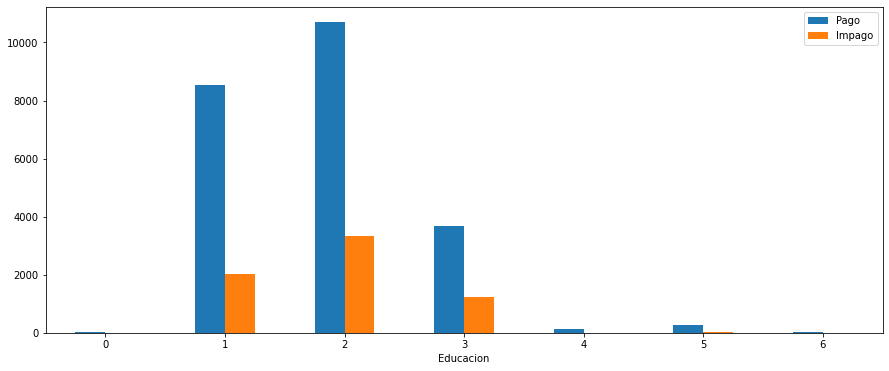

In [7]:
pd.crosstab(df.EDUCATION, df['default.payment.next.month']).plot(kind="bar",figsize=(15,6))
plt.xlabel('Educacion')
plt.xticks(rotation=0)
plt.legend(["Pago", "Impago"])
plt.show()

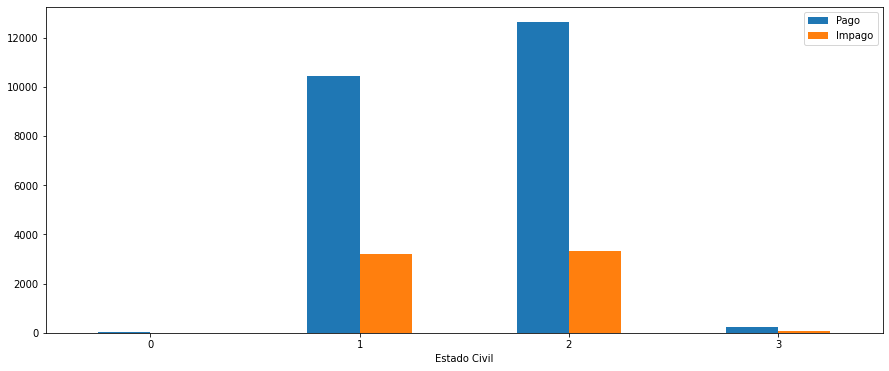

In [8]:
pd.crosstab(df.MARRIAGE, df['default.payment.next.month']).plot(kind="bar",figsize=(15,6))
plt.xlabel('Estado Civil')
plt.xticks(rotation=0)
plt.legend(["Pago", "Impago"])
plt.show()

### Correlacion 

In [9]:
correlation = df.corr()
correlation

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
ID,1.000000,0.026179,0.018497,0.039177,-0.029079,0.018678,-0.030575,-0.011215,-0.018494,-0.002735,...,0.040351,0.016705,0.016730,0.009742,0.008406,0.039151,0.007793,0.000652,0.003000,-0.013952
LIMIT_BAL,0.026179,1.000000,0.024755,-0.219161,-0.108139,0.144713,-0.271214,-0.296382,-0.286123,-0.267460,...,0.293988,0.295562,0.290389,0.195236,0.178408,0.210167,0.203242,0.217202,0.219595,-0.153520
SEX,0.018497,0.024755,1.000000,0.014232,-0.031389,-0.090874,-0.057643,-0.070771,-0.066096,-0.060173,...,-0.021880,-0.017005,-0.016733,-0.000242,-0.001391,-0.008597,-0.002229,-0.001667,-0.002766,-0.039961
EDUCATION,0.039177,-0.219161,0.014232,1.000000,-0.143464,0.175061,0.105364,0.121566,0.114025,0.108793,...,-0.000451,-0.007567,-0.009099,-0.037456,-0.030038,-0.039943,-0.038218,-0.040358,-0.037200,0.028006
MARRIAGE,-0.029079,-0.108139,-0.031389,-0.143464,1.000000,-0.414170,0.019917,0.024199,0.032688,0.033122,...,-0.023344,-0.025393,-0.021207,-0.005979,-0.008093,-0.003541,-0.012659,-0.001205,-0.006641,-0.024339
AGE,0.018678,0.144713,-0.090874,0.175061,-0.414170,1.000000,-0.039447,-0.050148,-0.053048,-0.049722,...,0.051353,0.049345,0.047613,0.026147,0.021785,0.029247,0.021379,0.022850,0.019478,0.013890
PAY_0,-0.030575,-0.271214,-0.057643,0.105364,0.019917,-0.039447,1.000000,0.672164,0.574245,0.538841,...,0.179125,0.180635,0.176980,-0.079269,-0.070101,-0.070561,-0.064005,-0.058190,-0.058673,0.324794
PAY_2,-0.011215,-0.296382,-0.070771,0.121566,0.024199,-0.050148,0.672164,1.000000,0.766552,0.662067,...,0.222237,0.221348,0.219403,-0.080701,-0.058990,-0.055901,-0.046858,-0.037093,-0.036500,0.263551
PAY_3,-0.018494,-0.286123,-0.066096,0.114025,0.032688,-0.053048,0.574245,0.766552,1.000000,0.777359,...,0.227202,0.225145,0.222327,0.001295,-0.066793,-0.053311,-0.046067,-0.035863,-0.035861,0.235253
PAY_4,-0.002735,-0.267460,-0.060173,0.108793,0.033122,-0.049722,0.538841,0.662067,0.777359,1.000000,...,0.245917,0.242902,0.239154,-0.009362,-0.001944,-0.069235,-0.043461,-0.033590,-0.026565,0.216614


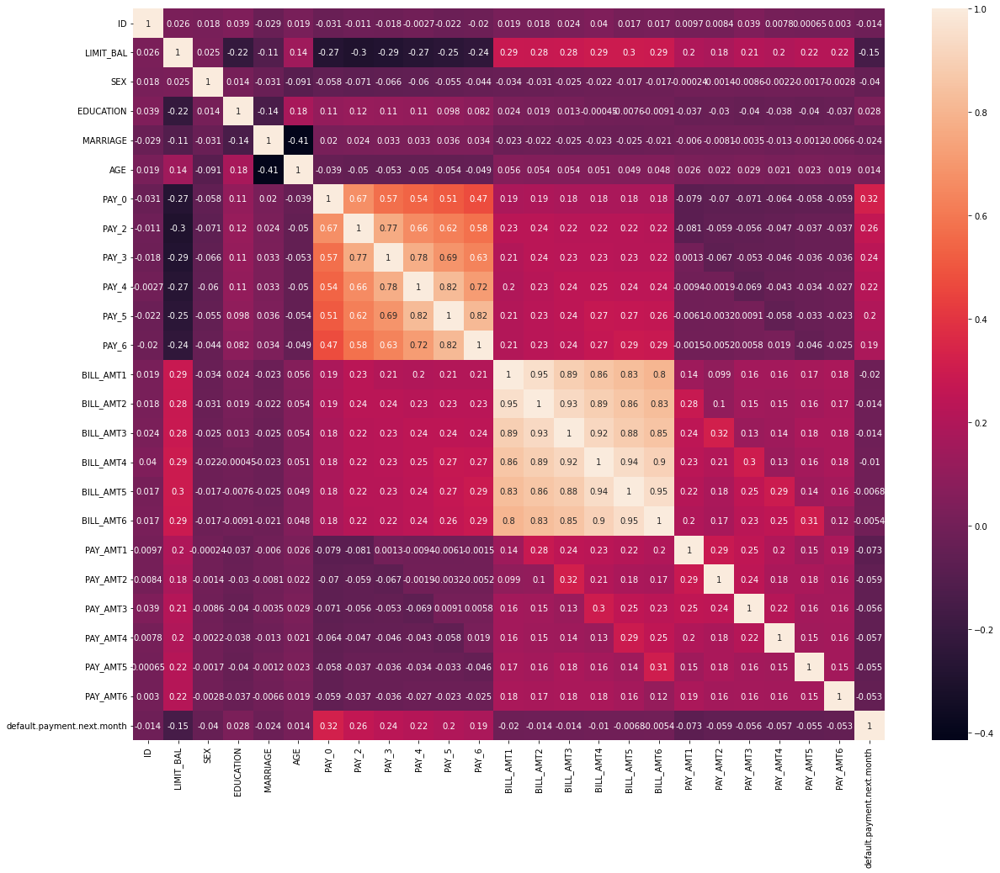

In [10]:
plt.figure(figsize = (20, 16))
sn.heatmap(correlation, annot=True)
plt.show()

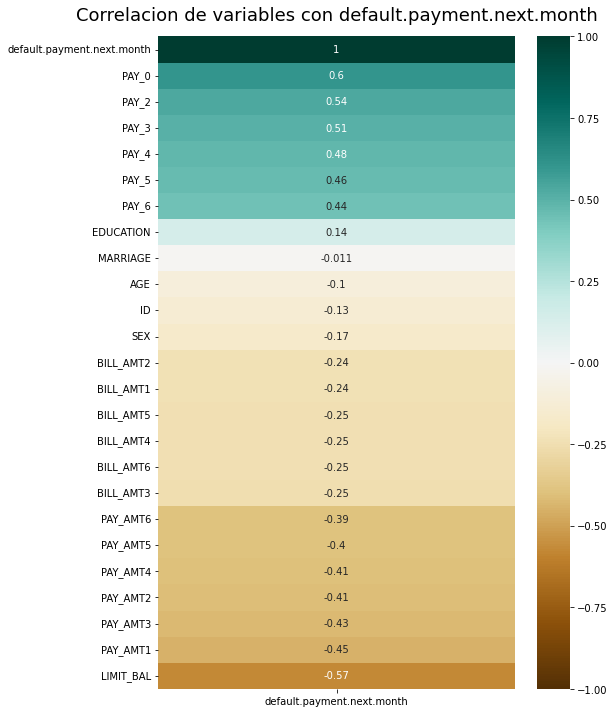

In [11]:
plt.figure(figsize=(8, 12))
heatmap = sn.heatmap(correlation.corr()[['default.payment.next.month']].sort_values(by='default.payment.next.month', ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlacion de variables con default.payment.next.month', fontdict={'fontsize':18}, pad=16);